<a href="https://colab.research.google.com/github/shivendr7/Radio-Propagation/blob/main/Retrieving_OSM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Install GDAL and Geopandas
!apt install gdal-bin python-gdal python3-gdal --quiet
!apt install python3-rtree --quiet
!pip install git+git://github.com/geopandas/geopandas.git --quiet
!pip install descartes --quiet
!pip install osmnx==0.10
!pip install folium


In [ ]:
import pandas as pd
import geopandas as gpd
import osmnx as ox
import folium
import matplotlib.pyplot as plt
import seaborn as sns

## Streets

In [ ]:
place = "Liverpool, United Kingdom"
graph = ox.graph_from_place(place, network_type='drive')

In [ ]:
len(graph)

14682

In [ ]:
nodes, streets = ox.graph_to_gdfs(graph)

In [ ]:
nodes.head()

,y,x,osmid,highway,ref,geometry
26705920,53.364957,-2.902761,26705920,NaN,NaN,POINT (-2.90276 53.36496)
26705921,53.366925,-2.914018,26705921,NaN,NaN,POINT (-2.91402 53.36693)
26705922,53.366908,-2.912516,26705922,NaN,NaN,POINT (-2.91252 53.36691)
26705923,53.367495,-2.914307,26705923,NaN,NaN,POINT (-2.91431 53.36749)
26705924,53.368129,-2.914500,26705924,NaN,NaN,POINT (-2.91450 53.36813)


In [ ]:
streets.head()

,u,v,key,osmid,name,highway,oneway,length,geometry,maxspeed,lanes,ref,access,bridge,junction,tunnel,service
0,26705920,26705901,0,4377432,Shirley Road,residential,False,232.809,"LINESTRING (-2.90276 53.36496, -2.90104 53.363...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,26705921,26353756,0,4330674,Cooper Avenue South,residential,False,117.231,"LINESTRING (-2.91402 53.36693, -2.91360 53.36590)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,26705921,25884533,0,4330674,Cooper Avenue South,residential,False,43.707,"LINESTRING (-2.91402 53.36693, -2.91420 53.36730)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,26705921,26705922,0,4377436,Cooper Close,residential,False,99.628,"LINESTRING (-2.91402 53.36693, -2.91252 53.36691)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,26705922,26705921,0,4377436,Cooper Close,residential,False,99.628,"LINESTRING (-2.91252 53.36691, -2.91402 53.36693)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
street_types = pd.DataFrame(streets["highway"].apply(pd.Series)[0].value_counts().reset_index())
street_types.columns = ["type", "count"]

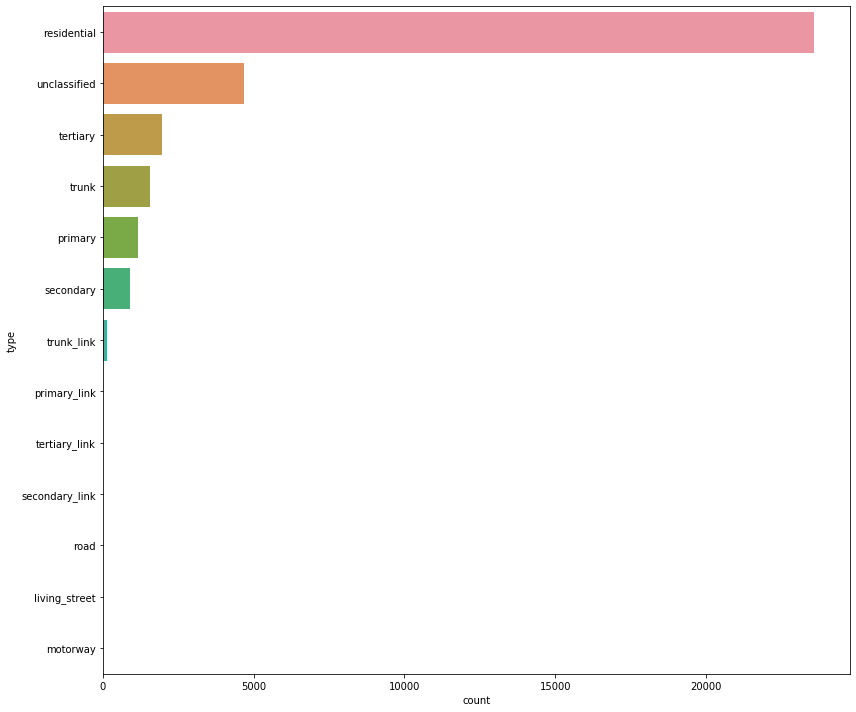

In [ ]:
fig, ax = plt.subplots(figsize=(12,10))
sns.barplot(y="type", x="count", data=street_types, ax=ax)
plt.tight_layout()
plt.savefig("barchart.png")

In [ ]:

style = {'color': '#F7DC6F', 'weight':'1'}
m = folium.Map([-2.914018, 53.366925],
               zoom_start=15,
               tiles="CartoDb dark_matter")
folium.GeoJson(streets, style_function=lambda x: style).add_to(m)
m.save("streets.html")
m

/usr/local/lib/python3.6/dist-packages/pyproj/crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


## Building footprints

In [ ]:
buildings = ox.footprints_from_place(place)

In [ ]:
buildings.head()

,nodes,geometry,amenity,building,name,created_by,building:part,name:ko,tourism,wikidata,wikipedia,addr:city,addr:street,building:levels,note,roof:colour,roof:shape,operator,leisure,website,postal_code,parking,wheelchair,addr:postcode,shop,wholesale,height,historic:aeroway,old_name,phone,addr:housename,historic,military,building:material,addr:housenumber,heritage,note:building,alt_name,building:colour,future_name,...,ele,contact:fax,contact:phone,year_of_construction,note:name,sport,raw_material,craft,screen,notes,history,healthcare,attraction,building:shape,common_name,works,highway,naptan:Bearing,naptan:CommonName,naptan:Indicator,naptan:Landmark,naptan:NaptanCode,naptan:Notes,naptan:PlusbusZoneRef,naptan:ShortCommonName,naptan:Street,naptan:verified,water,disused:amenity,isced:level,underground,note:building:part,source:levels,note:platforms,was:amenity,construction:building:levels,type,manager,building:use,description
4042138,"[21397944, 1277952783, 1277952779, 1277952781,...","POLYGON ((-2.90672 53.38366, -2.90693 53.38359...",library,public,Allerton Library,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5002097,"[33224193, 33224194, 33224195, 33224196, 33224...","POLYGON ((-2.86856 53.35665, -2.86828 53.35596...",NaN,yes,Buckingham Bingo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5011858,"[33368045, 33368046, 33368047, 33368048, 33368...","POLYGON ((-2.89850 53.37114, -2.89789 53.37137...",NaN,yes,Police Training Barracks,Potlatch alpha,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5099086,"[4501399414, 6142821450, 6142821481, 610928216...","POLYGON ((-2.98014 53.40809, -2.98007 53.40808...",NaN,yes,Saint George's Hall,NaN,no,세인트 조지 홀,attraction,Q1073341,"en:St George's Hall, Liverpool",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5099098,"[34874648, 6123978585, 6123978586, 6123978592,...","POLYGON ((-2.97895 53.40719, -2.97892 53.40745...",NaN,train_station,Liverpool Lime Street Railway Station,NaN,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
buildings.shape

(27330, 186)

In [ ]:
cols = ['amenity','building', 'name', 'tourism']
buildings[cols].head()

,amenity,building,name,tourism
4042138,library,public,Allerton Library,NaN
5002097,NaN,yes,Buckingham Bingo,NaN
5011858,NaN,yes,Police Training Barracks,NaN
5099086,NaN,yes,Saint George's Hall,attraction
5099098,NaN,train_station,Liverpool Lime Street Railway Station,NaN


In [ ]:
#list(buildings.columns)

In [ ]:
#buildings["amenity"].apply(pd.Series)[0].value_counts()


In [ ]:

style_buildings = {'color':'#6C3483 ', 'fillColor': '#6C3483 ', 'weight':'1', 'fillOpacity' : 1}

m = folium.Map([53.366925, -2.914018],
               zoom_start=15,

               tiles="Stamen Toner")

folium.GeoJson(buildings[:1000], style_function=lambda x: style_buildings).add_to(m)
m.save("buildings.html")
m

/usr/local/lib/python3.6/dist-packages/pyproj/crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


## Point of Interest - Cafes

In [ ]:
cafe = ox.pois_from_place(place, amenities=["cafe"])

In [ ]:
cafe.head()

,osmid,geometry,amenity,created_by,name,element_type,addr:housenumber,addr:postcode,source:addr,cuisine,internet_access,note,website,diet:vegan,diet:vegetarian,happycow:id,wheelchair,addr:city,addr:street,opening_hours,addr:place,fhrs:id,fixme:addr2,fixme:addr4,phone,source,wifi,toilets:wheelchair,addr:housename,level,email,twitter,brand,brand:wikidata,brand:wikipedia,operator,takeaway,smoking,outdoor_seating,official_name,old_name,old_shop,name:en,fixme:addr1,url,nodes,building,historic:amenity,payment:cash,payment:coins,payment:notes,payment:visa_debit
153003385,153003385,POINT (-3.00384 53.35606),cafe,Potlatch 0.5d,Cocoa coffee,node,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
262418334,262418334,POINT (-3.01618 53.36497),cafe,NaN,Chompers Cafe,node,226,CH42 4QF,FHRS Open Data,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
293651582,293651582,POINT (-2.89227 53.39446),cafe,Potlatch 0.10b,Simply Coffee,node,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
293653376,293653376,POINT (-2.89941 53.39060),cafe,Potlatch 0.10b,Neighbourhood,node,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
299317178,299317178,POINT (-2.97814 53.39343),cafe,NaN,Ryde,node,NaN,NaN,NaN,coffee_shop,yes,The Robert Cain Brewery,http://www.rydeliverpool.co.uk/,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
cafe.shape

(156, 52)

In [ ]:
cafe.columns

Index(['osmid', 'geometry', 'amenity', 'created_by', 'name', 'element_type',
       'addr:housenumber', 'addr:postcode', 'source:addr', 'cuisine',
       'internet_access', 'note', 'website', 'diet:vegan', 'diet:vegetarian',
       'happycow:id', 'wheelchair', 'addr:city', 'addr:street',
       'opening_hours', 'addr:place', 'fhrs:id', 'fixme:addr2', 'fixme:addr4',
       'phone', 'source', 'wifi', 'toilets:wheelchair', 'addr:housename',
       'level', 'email', 'twitter', 'brand', 'brand:wikidata',
       'brand:wikipedia', 'operator', 'takeaway', 'smoking', 'outdoor_seating',
       'official_name', 'old_name', 'old_shop', 'name:en', 'fixme:addr1',
       'url', 'nodes', 'building', 'historic:amenity', 'payment:cash',
       'payment:coins', 'payment:notes', 'payment:visa_debit'],
      dtype='object')

In [ ]:
columns =['osmid', 'name','wheelchair', 'opening_hours', 'addr:street', 'addr:city','addr:postcode']
cafe[columns].head()

,osmid,name,wheelchair,opening_hours,addr:street,addr:city,addr:postcode
153003385,153003385,Cocoa coffee,NaN,NaN,NaN,NaN,NaN
262418334,262418334,Chompers Cafe,NaN,NaN,NaN,NaN,CH42 4QF
293651582,293651582,Simply Coffee,NaN,NaN,NaN,NaN,NaN
293653376,293653376,Neighbourhood,NaN,NaN,NaN,NaN,NaN
299317178,299317178,Ryde,NaN,NaN,NaN,NaN,NaN


In [ ]:
cafe_points = cafe[cafe.geom_type == "Point"]

In [ ]:
m = folium.Map([53.366925, -2.914018], zoom_start=10, tiles="CartoDb dark_matter")
locs = zip(cafe_points.geometry.y, cafe_points.geometry.x)
#folium.GeoJson(buildings, style_function=lambda x: style_buildings).add_to(m)
for location in locs:
    folium.CircleMarker(location=location, 
        color = "#F4F6F7",   radius=2).add_to(m)
m.save("cafes.html")
m